Documentation and explanation available [here](tinyurl.com/gman-dehaze-net)  
[Github Repository](https://github.com/sanchitvj/Image-Dehazing-using-GMAN-net)

In [61]:
!pip uninstall tensorflow===2.2.0 --yes

Found existing installation: tensorflow 2.3.0
Uninstalling tensorflow-2.3.0:
  Successfully uninstalled tensorflow-2.3.0


In [62]:
!pip install tensorflow===2.2.0

  Using cached tensorflow-2.2.0-cp37-cp37m-manylinux2010_x86_64.whl (516.2 MB)
  Using cached tensorboard-2.2.2-py3-none-any.whl (3.0 MB)
  Using cached tensorflow_estimator-2.2.0-py2.py3-none-any.whl (454 kB)
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.11.2
    Uninstalling tensorboard-2.11.2:
      Successfully uninstalled tensorboard-2.11.2
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.3.0
    Uninstalling tensorflow-estimator-2.3.0:
      Successfully uninstalled tensorflow-estimator-2.3.0
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [63]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import glob
import random
from PIL import Image
import time
import datetime, zipfile

import tensorflow as tf
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.losses import mean_squared_error
from tensorflow.keras.optimizers import Adam 

# Preprocessing and loading of data

In [65]:
data_dir='/kaggle/input/dehaze'

In [66]:
# height,width=256,256
# batch_size=8
# validation_split=0.2

In [67]:
# train_datasets = tf.keras.utils.image_dataset_from_directory(
#     data_dir,
#     validation_split=0.2,
#     subset="training",
#     seed=123,
#     image_size=(224,224),  # Ensure consistent size
# #     batch_size=batch_size
# )

# validation_datasets = tf.keras.utils.image_dataset_from_directory(
#     data_dir,
#     validation_split=0.2,
#     subset="validation",
#     seed=123,
#     image_size=(224,224),  # Ensure consistent size
#     batch_size=8
# )


In [68]:
import tensorflow as tf
print(tf.__version__)


2.2.0


In [69]:
# from tensorflow.keras.layers import RandomFlip, RandomRotation, RandomZoom, RandomContrast, RandomBrightness

# # Data Augmentation
# data_augmentation = tf.keras.Sequential([
#     RandomFlip("horizontal"),    # Corrected the typo
#     RandomRotation(0.2),         # Rotate images by 20% (0.2)
#     RandomZoom(0.2)           # Zoom images by 20% (0.2       # Adjust brightness by up to 20% (0.2)
# ])


In [70]:
# # Apply data augmentation to the training dataset
# train_datasets = train_datasets.map(lambda x, y: (data_augmentation(x, training=True), y))

# # Use tf.data.AUTOTUNE for optimal performance
# autotune = tf.data.AUTOTUNE

# # Prefetch data to improve performance
# train_data = train_datasets.prefetch(buffer_size=autotune)
# validation_data = validation_datasets.prefetch(buffer_size=autotune)


In [71]:
# function to load the image in the form of tensors.

def load_image(img_path):
    img = tf.io.read_file(img_path) # returns string type tensor.
    img = tf.io.decode_jpeg(img, channels = 3)
    img = tf.image.resize(img, size = (224,224), antialias = True)
    img = img / 255.0
    return img

In [72]:
import glob
import random

def data_path(orig_img_path, hazy_img_path):


  # Get the list of original images
  orig_img = glob.glob(orig_img_path + '/*.jpg')
  n = len(orig_img)
  random.shuffle(orig_img)

  # Split the original images into 80% training, 15% validation, and 1% testing
  train_keys = orig_img[:int(0.83 * n)]  # 70% for training
  val_keys = orig_img[int(0.83 * n):int(0.9 * n)]  #15% for validation
  test_keys = orig_img[int(0.97 * n):]  # 1% for testing

  # Create a dictionary to store the split information
  split_dict = {}
  for key in train_keys:
      split_dict[key] = 'train'
  for key in val_keys:
      split_dict[key] = 'val'
  for key in test_keys:
      split_dict[key] = 'test'

  # Get the list of hazy images
  hazy_img = glob.glob(hazy_img_path + '/*.jpg')

  # Create lists to store the training, validation, and testing data
  train_img = []
  val_img = []
  test_img = []

  for img in hazy_img:
      img_name = img.split('/')[-1]
      orig_path = orig_img_path + '/' + img_name.split('_')[0] + '.jpg'

      # Determine if the image is for training, validation, or testing
      if split_dict.get(orig_path) == 'train':
          train_img.append([img, orig_path])
      elif split_dict.get(orig_path) == 'val':
          val_img.append([img, orig_path])
      elif split_dict.get(orig_path) == 'test':
          test_img.append([img, orig_path])

  return train_img, val_img, test_img

In [73]:
train_img,val_img,test_img=data_path(orig_img_path = '../input/dehaze/clear_images', hazy_img_path = '../input/dehaze/haze')
print("Size of training set:", len(train_img))
print("Size of validation set:", len(val_img))
print("Size of testing set:", len(test_img))

Size of training set: 10958
Size of validation set: 945
Size of testing set: 315


In [74]:
import tensorflow as tf

def dataloader(train_data, val_data, test_data, batch_size):
    """
    Creates TensorFlow dataset loaders for training, validation, and testing.
    
    Args:
    - train_data (list): List of training image paths (hazy and original).
    - val_data (list): List of validation image paths (hazy and original).
    - test_data (list): List of testing image paths (hazy and original).
    - batch_size (int): Batch size for loading data.
    
    Returns:
    - train (tf.data.Dataset): Batched training dataset.
    - val (tf.data.Dataset): Batched validation dataset.
    - test (tf.data.Dataset): Batched test dataset.
    """
    
    # Training dataset
    train_data_orig = tf.data.Dataset.from_tensor_slices([img[1] for img in train_data]).map(lambda x: load_image(x))
    train_data_haze = tf.data.Dataset.from_tensor_slices([img[0] for img in train_data]).map(lambda x: load_image(x))
    train = tf.data.Dataset.zip((train_data_haze, train_data_orig)).shuffle(buffer_size=100, reshuffle_each_iteration=True).batch(batch_size)

    # Validation dataset
    val_data_orig = tf.data.Dataset.from_tensor_slices([img[1] for img in val_data]).map(lambda x: load_image(x))
    val_data_haze = tf.data.Dataset.from_tensor_slices([img[0] for img in val_data]).map(lambda x: load_image(x))
    val = tf.data.Dataset.zip((val_data_haze, val_data_orig)).shuffle(buffer_size=100, reshuffle_each_iteration=True).batch(batch_size)
    
    # Test dataset (no shuffling)
    test_data_orig = tf.data.Dataset.from_tensor_slices([img[1] for img in test_data]).map(lambda x: load_image(x))
    test_data_haze = tf.data.Dataset.from_tensor_slices([img[0] for img in test_data]).map(lambda x: load_image(x))
    test = tf.data.Dataset.zip((test_data_haze, test_data_orig)).batch(batch_size)

    return train, val, test


In [75]:
# function to display output.
def display_img(model, hazy_img, orig_img):
    
    dehazed_img = model(hazy_img, training = True)
    plt.figure(figsize = (15,12))
    
    display_list = [hazy_img[0], orig_img[0], dehazed_img[0]]
    title = ['Hazy Image', 'Ground Truth', 'Dehazed Image']
    
    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')
    plt.show()

# Network Function

In [76]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Input, Add, Activation,Dropout

# Define custom initializers and regularizers
k_init = tf.keras.initializers.glorot_normal(seed=101)
b_init = tf.keras.initializers.Zeros()
regularizer = tf.keras.regularizers.l2(1e-4)

def gman_net():
    inputs = Input(shape=[224, 224, 3])  # height, width of input image

    # GMAN Network
    conv = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  bias_initializer=b_init, kernel_regularizer=regularizer)(inputs)
    conv = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  bias_initializer=b_init, kernel_regularizer=regularizer)(conv)

    # Encoding Layers
    conv_up = Conv2D(filters=128, kernel_size=3, strides=2, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv)
    conv_up = Conv2D(filters=128, kernel_size=3, strides=2, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv_up)

    # Residual Layers
    conv1_1 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv_up)
    conv1_2 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv1_1)
    conv1_3 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init,activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv1_2)
    conv1_4 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init,
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv1_3)
    
    conc1 = Add()([conv1_4, conv1_1])  # Replace tf.add with Keras Add layer
    conv1 = Activation('relu')(conc1)

    conv2_1 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv1)
    conv2_2 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv2_1)
    conv2_3 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init,
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv2_2)
    conc2 = Add()([conv2_3, conv2_1])
    conv2 = Activation('relu')(conc2)

    conv3_1 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv2)
    conv3_2 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv3_1)
    conv3_3 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv3_2)
    conv3_4 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv3_3)
    conv3_5 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init,activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv3_4)
    conv3_6 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init,
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv3_5)
    conc3 = Add()([conv3_6, conv3_1])
    conv3 = Activation('relu')(conc3)

    conv4_1 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv3)
    conv4_2 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv4_1)
    conv4_3 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv4_2)
    conv4_4 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init, activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv4_3)
    conv4_5 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init,activation='swish',
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv4_4)
    conv4_6 = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                     kernel_initializer=k_init,
                     bias_initializer=b_init, kernel_regularizer=regularizer)(conv4_5)
    conc4 = Add()([conv4_6, conv4_1])
    conv4 = Activation('relu')(conc4)

    # Decoding Layers
    deconv = Conv2DTranspose(filters=64, kernel_size=3, strides=2, padding='same',
                             kernel_initializer=k_init,
                             kernel_regularizer=regularizer)(conv4)
    deconv = Conv2DTranspose(filters=64, kernel_size=3, strides=2, padding='same',
                             kernel_initializer=k_init,
                             kernel_regularizer=regularizer)(deconv)

    conv = Conv2D(filters=64, kernel_size=3, strides=1, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  bias_initializer=b_init, kernel_regularizer=regularizer)(deconv)
    conv = Conv2D(filters=3, kernel_size=3, strides=1, padding='same',
                  kernel_initializer=k_init,
                  bias_initializer=b_init, kernel_regularizer=regularizer)(conv)
    conc = Add()([conv, inputs])  # Replace tf.add with Keras Add layer
    gman_output = Activation('relu')(conc)

    # Parallel Network
    conv = Conv2D(filters=64, kernel_size=3, dilation_rate=4, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  kernel_regularizer=regularizer)(inputs)
    conv = Conv2D(filters=64, kernel_size=3, dilation_rate=2, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  kernel_regularizer=regularizer)(conv)
    conv = Conv2D(filters=64, kernel_size=3, dilation_rate=2, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  kernel_regularizer=regularizer)(conv)
    conv = Conv2D(filters=64, kernel_size=3, dilation_rate=1, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  kernel_regularizer=regularizer)(conv)
    conv = Conv2D(filters=64, kernel_size=3, dilation_rate=1, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  kernel_regularizer=regularizer)(conv)
    conv = Conv2D(filters=64, kernel_size=3, dilation_rate=1, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  kernel_regularizer=regularizer)(conv)
    conv = Conv2D(filters=64, kernel_size=3, dilation_rate=1, padding='same',
                  kernel_initializer=k_init, activation='swish',
                  kernel_regularizer=regularizer)(conv)
    deconv = Conv2DTranspose(filters=64, kernel_size=3, dilation_rate=4, padding='same',
                             kernel_initializer=k_init, activation='swish',
                             kernel_regularizer=regularizer)(conv)
    conv = Conv2D(filters=3, kernel_size=3, strides=1, padding='same',
                  kernel_initializer=k_init,
                  kernel_regularizer=regularizer)(deconv)
    conc = Add()([conv, inputs])
    pn_output = Activation('relu')(conc)

    output = Add()([gman_output, pn_output])

    return Model(inputs=inputs, outputs=output)


In [77]:
model=gman_net()
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv2d_99 (Conv2D)              (None, 224, 224, 64) 1792        input_4[0][0]                    
__________________________________________________________________________________________________
conv2d_100 (Conv2D)             (None, 224, 224, 64) 36928       conv2d_99[0][0]                  
__________________________________________________________________________________________________
conv2d_101 (Conv2D)             (None, 112, 112, 128 73856       conv2d_100[0][0]                 
____________________________________________________________________________________________

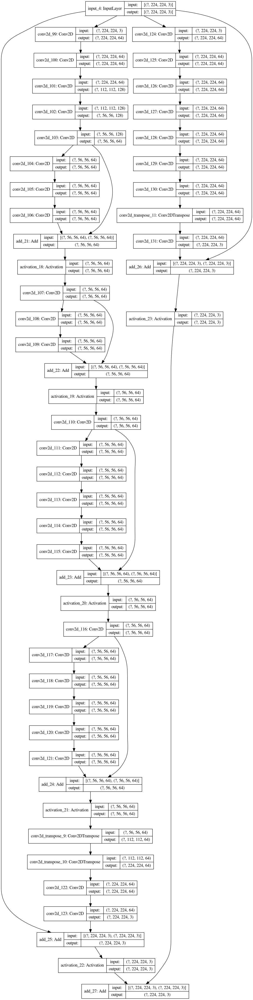

In [78]:
from keras.utils import plot_model
# Visualize the model architecture
plot_model(model, to_file='model_architecture.png', show_shapes=True)

# Hyperparameters

# Training and validation function

In [80]:

batch_size = 16
k_init = tf.keras.initializers.RandomNormal(stddev=0.008, seed = 101)      
regularizer = tf.keras.regularizers.l2(1e-4)
b_init = tf.constant_initializer()
from tensorflow.keras.metrics import Mean
import tensorflow_addons as tfa  # TensorFlow Addons for SSIM

# Correctly unpack the returned values from data_path
train_data, val_data, test_data = data_path(orig_img_path='/kaggle/input/dehaze/clear_images', hazy_img_path='/kaggle/input/dehaze/haze')

# Use all three datasets in the dataloader function
train, val, test = dataloader(train_data, val_data, test_data, batch_size)


optimizer = Adam(learning_rate = 1e-4)
net = gman_net()

train_loss_tracker = tf.keras.metrics.MeanSquaredError(name = "train loss")

val_loss_tracker = tf.keras.metrics.MeanSquaredError(name = "val loss")
train_psnr_tracker = Mean(name='train_psnr')
val_psnr_tracker = Mean(name='val_psnr')
train_ssim_tracker = Mean(name='train_ssim')
val_ssim_tracker = Mean(name='val_ssim')


In [81]:
import matplotlib.pyplot as plt
import time
import tensorflow as tf

def train_model(epochs, train, val, net, train_loss_tracker, val_loss_tracker,
                train_psnr_tracker, val_psnr_tracker, train_ssim_tracker, val_ssim_tracker,
                optimizer):
    # Lists to store metrics for plotting
    train_losses = []
    val_losses = []
    train_psnrs = []
    val_psnrs = []
    train_ssims = []
    val_ssims = []

    # Initialize maximum PSNR value
    max_val_psnr = 0

    def display_comparison(hazy_image, dehazed_image):
        """Displays a hazy image and its dehazed counterpart side-by-side."""
        fig, axs = plt.subplots(1, 2, figsize=(12, 6))
        axs[0].imshow(hazy_image)
        axs[0].set_title("Hazy Image")
        axs[1].imshow(dehazed_image)
        axs[1].set_title("Dehazed Image")
        plt.show()

    def visualize_results(train_losses, val_losses, train_psnrs, val_psnrs, train_ssims, val_ssims):
        plt.figure(figsize=(12, 8))
        plt.subplot(2, 3, 1)
        plt.plot(train_losses, label='Train Loss')
        plt.plot(val_losses, label='Val Loss')
        plt.title('Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend()

        plt.subplot(2, 3, 2)
        plt.plot(train_psnrs, label='Train PSNR')
        plt.plot(val_psnrs, label='Val PSNR')
        plt.title('PSNR')
        plt.xlabel('Epoch')
        plt.ylabel('PSNR')
        plt.legend()

        plt.subplot(2, 3, 3)
        plt.plot(train_ssims, label='Train SSIM')
        plt.plot(val_ssims, label='Val SSIM')
        plt.title('SSIM')
        plt.xlabel('Epoch')
        plt.ylabel('SSIM')
        plt.legend()

        plt.tight_layout()
        plt.show()

    for epoch in range(epochs):
        start_time = time.time()

        # Training loop
        for step, (train_batch_haze, train_batch_orig) in enumerate(train):
            with tf.GradientTape() as tape:
                train_logits = net(train_batch_haze, training=True)
                loss = tf.keras.losses.MeanSquaredError()(train_batch_orig, train_logits)

            gradients = tape.gradient(loss, net.trainable_variables)
            optimizer.apply_gradients(zip(gradients, net.trainable_variables))

            train_loss_tracker.update_state(train_batch_orig, train_logits)
            train_psnr_tracker.update_state(tf.image.psnr(train_batch_orig, train_logits, max_val=1.0))
            train_ssim_tracker.update_state(tf.image.ssim(train_batch_orig, train_logits, max_val=1.0))

        # Validation loop
        for step, (val_batch_haze, val_batch_orig) in enumerate(val):
            val_logits = net(val_batch_haze, training=False)
            val_loss = tf.keras.losses.MeanSquaredError()(val_batch_orig, val_logits)

            val_loss_tracker.update_state(val_batch_orig, val_logits)
            val_psnr_tracker.update_state(tf.image.psnr(val_batch_orig, val_logits, max_val=1.0))
            val_ssim_tracker.update_state(tf.image.ssim(val_batch_orig, val_logits, max_val=1.0))

        # Store metrics for plotting
        train_losses.append(train_loss_tracker.result().numpy())
        val_losses.append(val_loss_tracker.result().numpy())
        train_psnrs.append(train_psnr_tracker.result().numpy())
        val_psnrs.append(val_psnr_tracker.result().numpy())
        train_ssims.append(train_ssim_tracker.result().numpy())
        val_ssims.append(val_ssim_tracker.result().numpy())

        # Check and update the maximum PSNR value
        if val_psnrs[-1] > max_val_psnr:
            max_val_psnr = val_psnrs[-1]

        # Log metrics
        print(f"Epoch {epoch+1}, Training Loss: {train_losses[-1]}, "
              f"Training PSNR: {train_psnrs[-1]}, "
              f"Training SSIM: {train_ssims[-1]}, "
              f"Validation Loss: {val_losses[-1]}, "
              f"Validation PSNR: {val_psnrs[-1]}, "
              f"Validation SSIM: {val_ssims[-1]}, "
              f"Time taken: {time.time() - start_time:.2f}s")

        # Reset metrics at the end of each epoch
        train_loss_tracker.reset_states()
        val_loss_tracker.reset_states()
        train_psnr_tracker.reset_states()
        val_psnr_tracker.reset_states()
        train_ssim_tracker.reset_states()
        val_ssim_tracker.reset_states()

    # Print the maximum PSNR value
    print(f"Maximum Validation PSNR reached during training: {max_val_psnr:.2f}")

    # Visualize results
    visualize_results(train_losses, val_losses, train_psnrs, val_psnrs, train_ssims, val_ssims)


Epoch 1, Training Loss: 0.04614444822072983, Training PSNR: 19.080608367919922, Training SSIM: 0.8698366284370422, Validation Loss: 0.011331054382026196, Validation PSNR: 20.855043411254883, Validation SSIM: 0.8919066190719604, Time taken: 597.16s
Epoch 2, Training Loss: 0.011713681742548943, Training PSNR: 20.53488540649414, Training SSIM: 0.8975324034690857, Validation Loss: 0.010947431437671185, Validation PSNR: 20.641416549682617, Validation SSIM: 0.8871033191680908, Time taken: 529.65s
Epoch 3, Training Loss: 0.008902196772396564, Training PSNR: 22.051502227783203, Training SSIM: 0.8992284536361694, Validation Loss: 0.005861617159098387, Validation PSNR: 24.116933822631836, Validation SSIM: 0.9078592658042908, Time taken: 529.26s
Epoch 4, Training Loss: 0.006184473168104887, Training PSNR: 23.626449584960938, Training SSIM: 0.9122973084449768, Validation Loss: 0.00375951430760324, Validation PSNR: 25.388526916503906, Validation SSIM: 0.9240265488624573, Time taken: 528.08s
Epoch 5

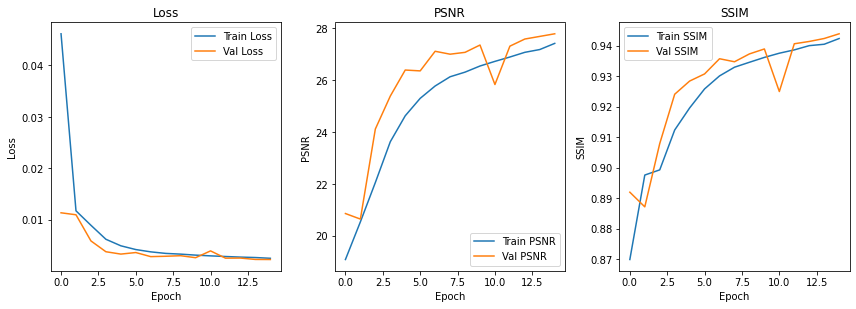

Total Training Time: 8015.89s


In [82]:
# Measure the time taken for training
epochs = 15
start_time = time.time()
train_model(epochs, train, val, net, train_loss_tracker, val_loss_tracker, 
            train_psnr_tracker, val_psnr_tracker, train_ssim_tracker, val_ssim_tracker, 
            optimizer)
print(f"Total Training Time: {time.time() - start_time:.2f}s")


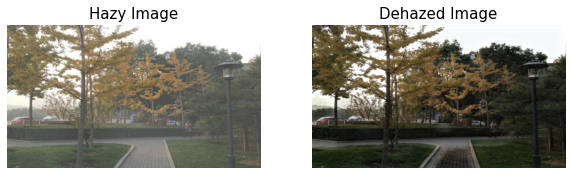

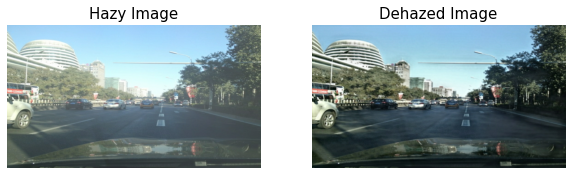

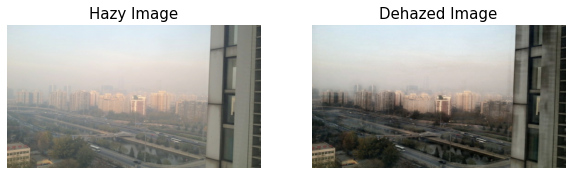

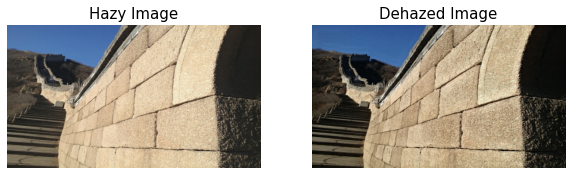

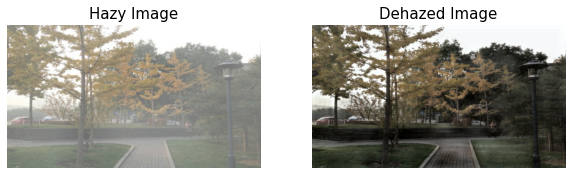

...

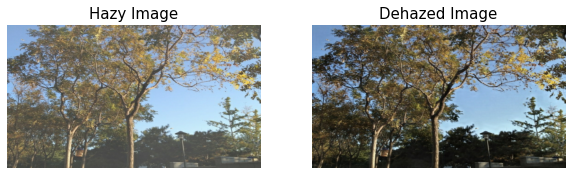

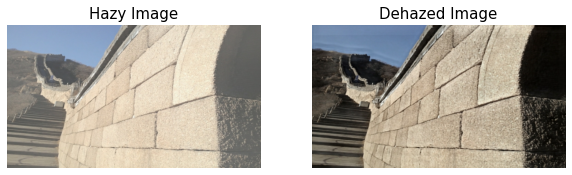

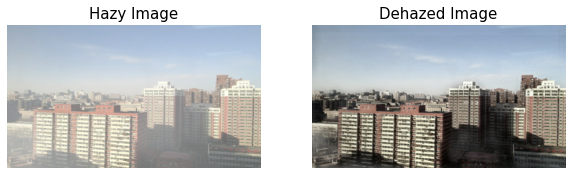

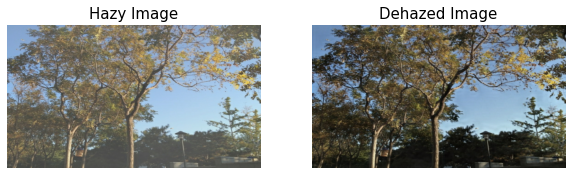

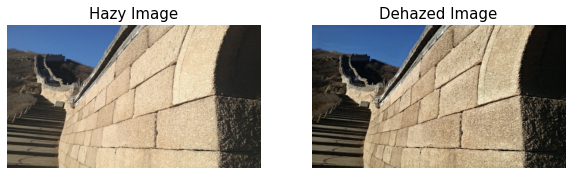

KeyboardInterrupt: 

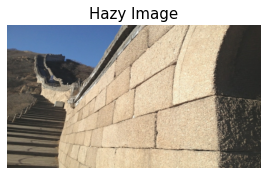

In [85]:
import tensorflow as tf
import matplotlib.pyplot as plt
import random

def evaluate(net, test_data):
    """
    Function to evaluate the model on test images.
    
    Args:
    - net: The trained model.
    - test_data (list): List of tuples containing paths of hazy and original test images.
    """
    # Extract hazy image paths from the test data
    test_img_paths = [img[0] for img in test_data]  # Extract only the hazy image paths
    random.shuffle(test_img_paths)  # Shuffle test images for random display
    
    for img_path in test_img_paths:
        # Read and preprocess the test image
        img = tf.io.read_file(img_path)
        img = tf.io.decode_jpeg(img, channels=3)
        
        # Check and resize image based on orientation
        if img.shape[1] > img.shape[0]:  # Landscape orientation
            img = tf.image.resize(img, size=(1080, 1920), antialias=True)
        elif img.shape[1] < img.shape[0]:  # Portrait orientation
            img = tf.image.resize(img, size=(1920, 1080), antialias=True)
        
        img = img / 255.0  # Normalize to [0, 1] range
        img = tf.expand_dims(img, axis=0)  # Expand dims for batch size of 1
        
        # Predict dehazed image
        dehaze = net(img, training=False)
        
        # Plot original hazy and dehazed images
        plt.figure(figsize=(10, 10))
        
        display_list = [img[0], dehaze[0]]  # Convert batch dimension to first index
        title = ['Hazy Image', 'Dehazed Image']

        for i in range(2):
            plt.subplot(1, 2, i + 1)
            plt.title(title[i], fontsize=15)
            plt.imshow(display_list[i])
            plt.axis('off')
        
        plt.show()

# Example call to the evaluate function with the test dataset
evaluate(net, test_data)


In [84]:
net.save('gman_net_model.h5')

In [86]:
import tensorflow as tf
import matplotlib.pyplot as plt
import random

class DehazeModel:
    def __init__(self, model_path=None):
        """
        Initializes the DehazeModel class, loading the model if a model path is provided.
        
        Args:
        - model_path (str): Path to the saved model.
        """
        if model_path:
            self.load_model(model_path)
        else:
            self.model = None

    def load_model(self, model_path):
        """
        Loads the model architecture and weights.
        
        Args:
        - model_path (str): Path to the saved model file.
        """
        self.model = tf.keras.models.load_model(model_path)  # Load the entire model

    def preprocess_image(self, img_path):
        """
        Preprocesses an image from the specified path to prepare it for model input.
        
        Args:
        - img_path (str): Path to the image file.
        
        Returns:
        - img (tf.Tensor): Preprocessed image tensor ready for prediction.
        """
        # Load and decode the image
        img = tf.io.read_file(img_path)
        img = tf.io.decode_jpeg(img, channels=3)
        
        # Resize image based on its orientation
        if img.shape[1] > img.shape[0]:  # Landscape orientation
            img = tf.image.resize(img, size=(1080, 1920), antialias=True)
        elif img.shape[1] < img.shape[0]:  # Portrait orientation
            img = tf.image.resize(img, size=(1920, 1080), antialias=True)
        
        img = img / 255.0  # Normalize to [0, 1] range
        img = tf.expand_dims(img, axis=0)  # Expand dims for batch size of 1
        return img

    def predict(self, img):
        """
        Predicts the dehazed image for the given preprocessed image tensor.
        
        Args:
        - img (tf.Tensor): Preprocessed image tensor.
        
        Returns:
        - tf.Tensor: Predicted dehazed image tensor.
        """
        if self.model is None:
            raise ValueError("Model not loaded. Please load the model first.")
        return self.model(img, training=False)

    def process_and_predict(self, img_path):
        """
        Processes an image and predicts the dehazed output.
        
        Args:
        - img_path (str): Path to the image file.
        
        Returns:
        - tf.Tensor: Predicted dehazed image tensor.
        """
        img = self.preprocess_image(img_path)
        return self.predict(img)

    def display_results(self, img_path):
        """
        Displays the hazy and predicted dehazed images side by side.
        
        Args:
        - img_path (str): Path to the hazy image.
        """
        hazy_img = self.preprocess_image(img_path)
        dehazed_img = self.predict(hazy_img)

        # Display both the original hazy and dehazed images
        plt.figure(figsize=(10, 10))
        display_list = [hazy_img[0], dehazed_img[0]]
        title = ['Hazy Image', 'Dehazed Image']

        for i in range(2):
            plt.subplot(1, 2, i + 1)
            plt.title(title[i], fontsize=15)
            plt.imshow(display_list[i])
            plt.axis('off')
        
        plt.show()


In [87]:
d_model = DehazeModel(model_path="gman_net_model.h5")

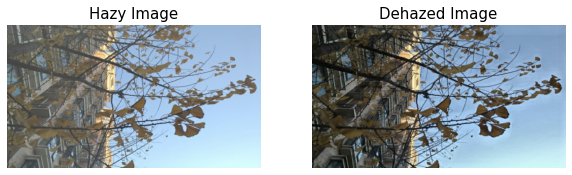

In [92]:
d_model.display_results('/kaggle/input/dehaze/haze/0468_1_0.12.jpg')
